# Tutorial: How to calibrate the OpenHSI camera


This is not for genral use. add warning.

In [ ]:
#all_hardware

In [ ]:
import os

import holoviews as hv
import numpy as np

from openhsi.calibrate import SettingsBuilderMixin, specta_pt_contoller, sum_gaussians
from openhsi.cameras import LucidCamera

hv.extension("bokeh", logo=False)
import panel as pn


class CalibrateLucidCamera(SettingsBuilderMixin, LucidCamera):
    pass

json_path_template = "../cals/cam_settings_lucid_template.json"
pkl_path = ""

modelno = 5

print("".format(modelno))

json_path_target = "../cals/OpenHSI-{0:02d}/OpenHSI-{0:02d}_settings_Mono8_bin1.json".format(
    modelno
)
pkl_path_target = "../cals/OpenHSI-{0:02d}/OpenHSI-{0:02d}_calibration_Mono8_bin1.pkl".format(
    modelno
)

if not os.path.isdir(os.path.dirname(json_path_target)):
    os.mkdir(os.path.dirname(json_path_target))

spt = specta_pt_contoller()

## Find illuminated sensor area

The vertical directon/y axis of the detector array corrspeonds the across-track direction of the sensor. If the image of slit is shorter then the heigh we can crop the top and bottom to save bandwidth/disk space (similar to letterboxing video).

There are two ways to do this, croping after the fact using row_minmax or by setting up a window on the sensor. Setting up a window will reduce the ammount of data transfered from the sensor and can improve maximum framerate depending on the sensor so is recomended.

### 1. Take a flat field

First step is to provide a uniform illumination to the slit, ideally spectrally broadband, like a halogen lamp or the sun.

In [ ]:
spt.selectPreset(10000)

with CalibrateLucidCamera(
    json_path=json_path_template, pkl_path="", processing_lvl=-1, exposure_ms=20
) as cam:

    hvim_flat = cam.retake_flat_field(show=True)
    hvim_flat.opts(width=600, height=600, axiswise=True)

    hvim_row_minmax = cam.update_row_minmax(edgezone=0)
    hvim_row_minmax.opts(width=600, height=600, axiswise=True)

    # Use Row min max to update window
    windowheight = int(
        np.ceil((cam.settings["row_slice"][1] - cam.settings["row_slice"][0]) / 4.0) * 4
    )
    print("Windowheight {}".format(windowheight))

    cam.settings["win_resolution"] = [windowheight + 16, cam.settings["resolution"][1]]
    cam.settings["win_offset"] = [
        int(np.ceil((cam.settings["row_slice"][0]) / 4.0) * 4) - 8,
        cam.settings["win_offset"][1],
    ]

    cam.settings["row_slice"] = [16, windowheight - 8]

    cam.settings["resolution"] = cam.settings["win_resolution"]
    cam.dump(json_path=json_path_target, pkl_path=pkl_path_target)
#     img=cam.crop(cam.calibration["flat_field_pic"])
#     hv_flatcrop=hv.Image(img, bounds=(0,0,*img.shape)).opts(xlabel="wavelength index",ylabel="cross-track",cmap="gray",title="test frame",width=400,height=400,axiswise=True)

# spt.selectPreset(1000)
pn.Column(hvim_row_minmax, hvim_flat)

Locs row_min: 114 and row_max: 1006
Windowheight 892


Column
    [0] HoloViews(Overlay)
    [1] HoloViews(Image)

In [ ]:
with CalibrateLucidCamera(
    n_lines=50,
    processing_lvl=0,
    pkl_path=pkl_path_target,
    json_path=json_path_target,
    exposure_ms=10,
) as cam:
    # cam.collect()
    cam.start_cam()
    img = cam.get_img()
    img = cam.crop(img)
    cam.stop_cam()
    # cam.show(hist_eq=True)

hv.Image(img, bounds=(0, 0, *img.shape)).opts(
    xlabel="wavelength index",
    ylabel="cross-track",
    cmap="gray",
    title="test frame",
    width=400,
    height=400,
)

:Image   [x,y]   (z)

### 2. Take Arc and setup wavelength scale, and get window for 430 to 900nm

255.0


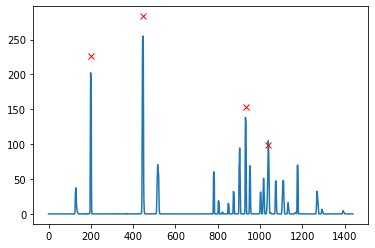

Peak 0 at col 445.8972115431864 - default wavelength 546.96:


Peak 1 at col 199.9679861415188 - default wavelength 435.833:


Peak 2 at col 932.1137354896221 - default wavelength 579.513:


 763.5


Peak 3 at col 1039.2925419285743 - default wavelength 763.511:


 811.5


predicted_λ [404.59394007 436.30668165 546.26257789 578.10721401 696.41191481
 706.59659918 727.24211146 738.38310309 750.74839232 763.65184332
 772.61655342 795.25081252 801.55691018 811.57189715 827.25484358
 842.79265123 853.35192355 873.39613202 914.86509467] for [ 129.0387296   199.96798614  445.89721154  517.12146565  781.72376917
  804.50300723  850.67911072  875.59724184  903.25365779  932.11373549
  952.1643584  1002.7885268  1016.89285195 1039.29254193 1074.36928634
 1109.12141086 1132.73845871 1177.56967589 1270.31986219] 


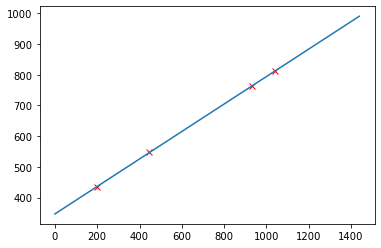

0.06205993234812013
0.4736816482329118
0.1885778883365674
0.9587859916828165
0.13108518600495245
0.12540082083546622
0.05188853650327019
0.009896912263684499
0.36139231845118047
0.14084331606227352
0.24055341969460642
0.4328125211876568
0.9409101785890925
0.04089714736937822
0.8028435840419661
0.3276512254570889
10.886923547518563
30.931132023793907
2.568094666323532


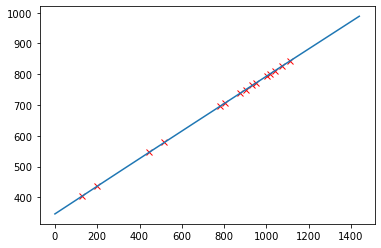

Window Width 1060, offset x 180


In [ ]:
# hardware

with CalibrateLucidCamera(
    json_path=json_path_target, pkl_path="", processing_lvl=-1
) as cam:
    cam.deviceSettings["Gain"].value = 10.0
    hvimg = cam.retake_HgAr(show=True, numframes=18)
    # hvimg=hv.Image(cam.crop(cam.calibration["HgAr_pic"]), bounds=(0,0,*cam.calibration["HgAr_pic"].shape)).opts(
    #                 xlabel="wavelength index",ylabel="cross-track",cmap="gray",title="HgAr spectra picture")

    hvimg.opts(width=600, height=600)
    print(cam.calibration["HgAr_pic"].max())
    smile_fit_hv = cam.update_smile_shifts()

    # cam.deviceSettings['Gain'].value=15.
    # hvimg=cam.retake_HgAr(show=True,numframes=18)

    cam.calibration["smile_shifts"] = cam.calibration["smile_shifts"] * 0

    wavefit_hv = cam.fit_HgAr_lines(
        top_k=15,
        brightest_peaks=[546.96, 435.833, (579.960 + 579.066) / 2, 763.511],
        find_peaks_height=10,
        prominence=1,
        width=1.5,
        interactive_peak_id=True,
    )  # [435.833,546.074,,763.511]

    # Use wavecal to narrow spetral range.
    waveminmax = [430, 900]
    waveminmax_ind = [
        np.argmin(np.abs(cam.calibration["wavelengths_linear"] - λ)) for λ in waveminmax
    ]

    window_width = int(np.ceil((waveminmax_ind[1] - waveminmax_ind[0] + 8) / 4.0) * 4)
    offset_x = int(np.floor((waveminmax_ind[0] - 4) / 4.0) * 4)
    print("Window Width {}, offset x {}".format(window_width, offset_x))

    cam.settings["win_resolution"][1] = window_width
    cam.settings["win_offset"][1] = offset_x
    cam.settings["resolution"] = cam.settings["win_resolution"]

    pn.Column(
        hvimg,
        smile_fit_hv,
        wavefit_hv.opts(xlim=(390, 1000), ylim=(-10, 255)).opts(shared_axes=False),
    )

In [ ]:
pn.Column(
    hvimg.opts(shared_axes=False),
    smile_fit_hv.opts(shared_axes=False),
    wavefit_hv.opts(xlim=(400, 900), ylim=(-10, 255)).opts(shared_axes=False),
)

NameError: name 'pn' is not defined

In [ ]:
cam.dump(json_path=json_path_target, pkl_path=pkl_path_target)

### 3. Retake flat field and arc with windows

In [ ]:
spt.selectPreset(10000)

with CalibrateLucidCamera(
    json_path=json_path_target, pkl_path=pkl_path_target, processing_lvl=-1
) as cam:
    hvim_flat = cam.retake_flat_field(show=True)
    hvim_flat.opts(width=600, height=600, axiswise=True)

    hvim_row_minmax = cam.update_row_minmax(edgezone=8)
    hvim_row_minmax.opts(width=600, height=600, axiswise=True)

    cam.update_resolution()
    cam.dump(json_path=json_path_target, pkl_path=pkl_path_target)

# spt.turnOffLamp()

hvim_row_minmax + hvim_flat

Locs row_min: 6 and row_max: 898


:Layout
   .Overlay.I :Overlay
      .Curve.I     :Curve   [x]   (y)
      .Curve.A_14  :Curve   [x]   (y)
      .Curve.A_890 :Curve   [x]   (y)
   .Image.I   :Image   [x,y]   (z)

### Redo Arc with window.

255.0


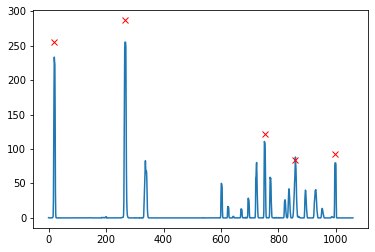

Peak 0 at col 266.87599002997126 - default wavelength 546.96:


Peak 1 at col 20.682102796392982 - default wavelength 435.833:


Peak 2 at col 752.3502519852548 - default wavelength 579.513:


 763.5


Peak 3 at col 998.0482193243249 - default wavelength 871.66:


 871.666


Peak 4 at col 858.9764823218694 - default wavelength 763.511:


 811.5


predicted_λ [436.47752286 546.38225731 578.1822353  696.07170301 706.25163332
 726.80962642 737.88374838 750.21699862 763.10542798 772.02259018
 794.5558047  800.8336565  810.70501569 826.44914295 841.92755523
 852.45634503 872.78877616] for [ 20.6821028  266.87599003 338.11004774 602.19026654 624.99398493
 671.04525162 695.85201855 723.47931625 752.35025199 772.32528616
 822.80117967 836.86398368 858.97648232 894.24437055 928.91703963
 952.50222641 998.04821932] 


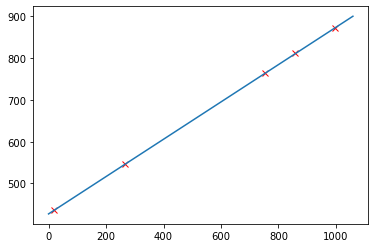

0.6445228604600288
0.3082573071782235
0.8837646982176466
0.4712969853832192
0.4703666815937595
0.48437357632712974
0.5092516208669622
0.1700013834215497
0.40557202250329283
0.35340981813669714
0.2621953046136696
0.21765650107579404
0.8259843077928508
0.002857050534203154
0.5374447698189897
9.991345033588573
30.323776162657964


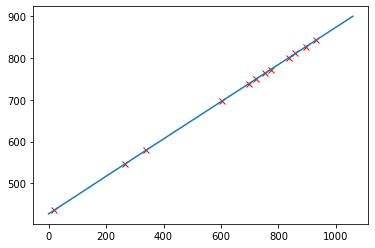

:Layout
   .Image.I   :Image   [x,y]   (z)
   .Curve.I   :Curve   [x]   (y)
   .Overlay.I :Overlay
      .Curve.I    :Curve   [x]   (y)
      .Curve.II   :Curve   [x]   (y)
      .Curve.III  :Curve   [x]   (y)
      .Curve.IV   :Curve   [x]   (y)
      .Curve.V    :Curve   [x]   (y)
      .Curve.VI   :Curve   [x]   (y)
      .Curve.VII  :Curve   [x]   (y)
      .Curve.VIII :Curve   [x]   (y)
      .Curve.IX   :Curve   [x]   (y)
      .Curve.X    :Curve   [x]   (y)
      .Curve.XI   :Curve   [x]   (y)
      .Curve.XII  :Curve   [x]   (y)
      .Curve.XIII :Curve   [x]   (y)

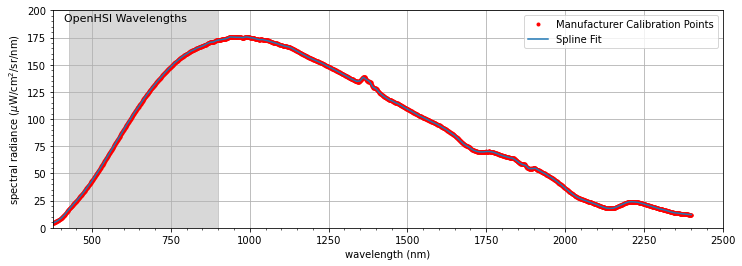

In [ ]:
with CalibrateLucidCamera(
    json_path=json_path_target, pkl_path=pkl_path_target, processing_lvl=-1
) as cam:
    cam.deviceSettings["Gain"].value = 10.0
    hvimg = cam.retake_HgAr(show=True)

    hvimg.opts(width=400, height=400)
    print(cam.calibration["HgAr_pic"].max())
    smile_fit_hv = cam.update_smile_shifts()

    wavefit_hv = cam.fit_HgAr_lines(
        top_k=12,
        brightest_peaks=[546.96, 435.833, (579.960 + 579.066) / 2, 871.66, 763.511],
        find_peaks_height=10,
        prominence=1,
        width=1.5,
        max_match_error=2,
        interactive_peak_id=True,
    )  # [435.833,546.074,(579.960+579.066)/2,763.511]
    
    cam.update_intsphere_fit()

    cam.dump(json_path=json_path_target, pkl_path=pkl_path_target)

(hvimg + smile_fit_hv + wavefit_hv.opts(xlim=(400, 900), ylim=(-10, 255))).opts(
    shared_axes=False
)

### 3. Get Integrating Sphere data for radiance calibration

4D datacube with coordinates of cross-track, wavelength, exposure, and luminance.

In [ ]:
lum_preset_dict = {
    0: 1,
    1000: 2,
    2000: 3,
    3000: 4,
    4000: 5,
    5000: 6,
    6000: 7,
    7000: 8,
    8000: 9,
    9000: 10,
    10000: 11,
    20000: 12,
    25000: 13,
    30000: 15,
    35000: 15,
    40000: 16,
}

lum_preset_dict = {
    0: 1,
    1000: 2,
    2000: 3,
    4000: 5,
    6000: 7,
    8000: 9,
    10000: 11,
    20000: 12,
    40000: 16,
}

luminances = np.fromiter(lum_preset_dict.keys(), dtype=int)
# luminances = np.append(luminances,0)
exposures = [0, 5, 8, 10, 15, 20]

with CalibrateLucidCamera(
    json_path=json_path_target, pkl_path=pkl_path_target, processing_lvl=-1
) as cam:

    cam.calibration["rad_ref"] = cam.update_intsphere_cube(
        exposures, luminances, noframe=50, lum_chg_func=spt.selectPreset
    )

    # remove saturated images
    cam.calibration["rad_ref"] = cam.calibration["rad_ref"].where(
        ~(
            np.sum((cam.calibration["rad_ref"][:, :, :, :, :] == 255), axis=(1, 2))
            > 1000
        )
    )
    cam.dump(json_path=json_path_target, pkl_path=pkl_path_target)

spt.turnOffLamp()

In [ ]:
cam.calibration["rad_ref"].plot(
    y="cross_track", x="wavelength_index", col="exposure", row="luminance", cmap="gray"
)

In [ ]:
print("rad_ref is {} MB".format(cam.calibration["rad_ref"].size / 1024 / 1024 * 4))

In [ ]:
cam.update_intsphere_fit()
cam.dump(json_path=json_path_target, pkl_path=pkl_path_target)